In [31]:
import librosa
import librosa.display
import numpy as np
import matplotlib.pyplot as plt
import pylab
from os import scandir
import contextlib
import random
import wave

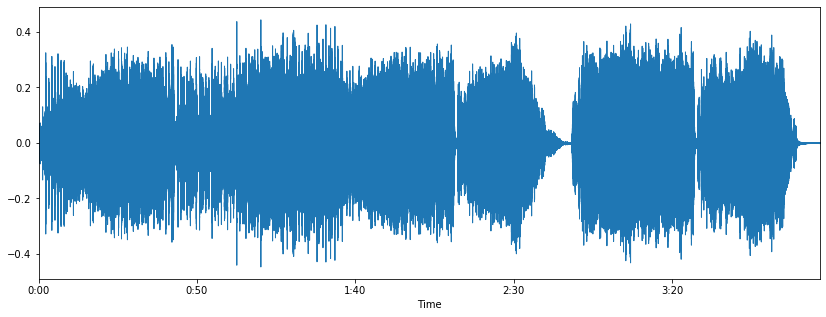

In [32]:
filename = '../../../PD/cancionesytags/313.wav'

y, sr = librosa.load(filename,  sr=None, duration=247)
# trim silent edges

plt.figure(figsize=(14, 5))
whale_song, _ = librosa.effects.trim(y)
librosa.display.waveplot(whale_song, sr=sr);

In [33]:
sr

48000

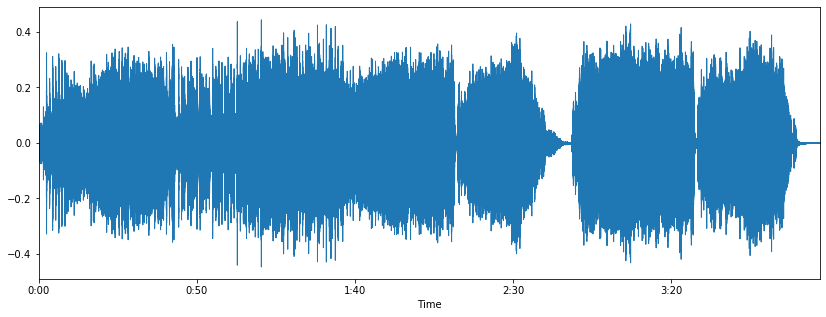

In [34]:
plt.figure(figsize=(14, 5))
librosa.display.waveplot(y, sr)

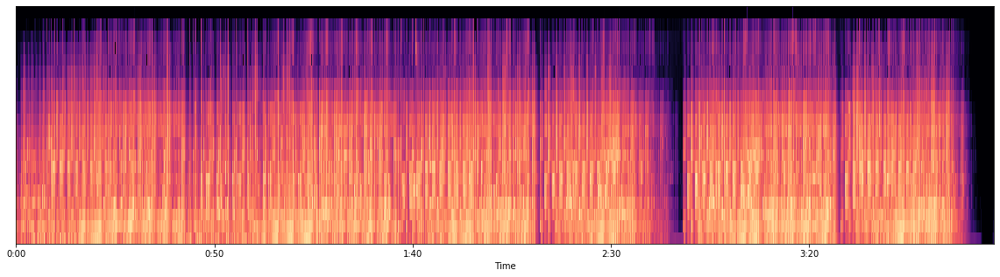

In [35]:
save_path = "./Data/Spectrograms/Images/313.jpg"

n_mels = 20
hop_length = 512
n_fft = 2048

fig, ax1 = plt.subplots(1,1, figsize = (20,5))
S = librosa.feature.melspectrogram(whale_song, sr=sr, n_fft=n_fft, 
                                   hop_length=hop_length, 
                                   n_mels=n_mels)
S_DB = librosa.power_to_db(S, ref=np.max)
#librosa.display.specshow(S_DB, sr=sr, hop_length=hop_length, 
#                         x_axis='time', y_axis='mel');

librosa.display.specshow(S_DB, sr=sr, hop_length=hop_length, 
                         x_axis='time');


#plt.colorbar(format='%+2.0f dB');

#pylab.savefig(save_path, bbox_inches=None, pad_inches=0)
#pylab.close()
plt.show()

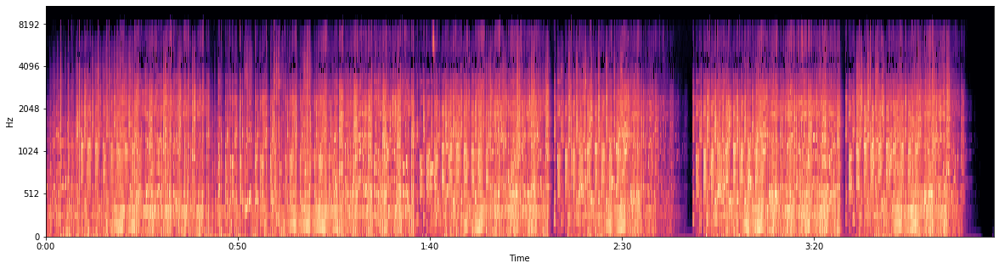

In [36]:
save_path = "./Data/Spectrograms/Images/313.jpg"

n_mels = 40
hop_length = 512
n_fft = 2048

# 44100 frecuencia muestreo sr

fig, ax1 = plt.subplots(1,1, figsize = (20,5))
S = librosa.feature.melspectrogram(whale_song, sr=sr, n_fft=n_fft, 
                                   hop_length=hop_length, 
                                   n_mels=n_mels)
S_DB = librosa.power_to_db(S, ref=np.max)
librosa.display.specshow(S_DB, sr=sr, hop_length=hop_length, 
                         x_axis='time', y_axis='mel');

#librosa.display.specshow(S_DB, sr=sr, hop_length=hop_length, 
#                         x_axis='time');
#librosa.display.specshow(S_DB, sr=sr, hop_length=hop_length);


#plt.colorbar(format='%+2.0f dB');

#pylab.savefig(save_path, bbox_inches=None, pad_inches=0)
#pylab.close()
plt.show()

In [37]:
oneSecLength = len(S_DB[0])/247

In [38]:
print("Cada columna de la matriz equivale a " + str((1/oneSecLength)*1000)+ " ms")

Cada columna de la matriz equivale a 10.680157391793141 ms


In [39]:
len(S_DB)

40

In [40]:
93*247

22971

In [41]:
def ls(path): 
    return [obj.name for obj in scandir(path) if obj.is_file()]

In [42]:
path = '../../../PD/cancionesytags'
songs = ls(path)
msg = ""
for song in songs:
    print(song)
    data = song.split(".")
    if data[1] == "wav":
        file_path = path+"/"+song
        
        
        y, sr = librosa.load(file_path, sr=48000)
        # trim silent edges
        #plt.figure(figsize=(14, 5))
        whale_song, _ = librosa.effects.trim(y)
        save_path = "./Data/Spectrograms/Images/"+data[0]+".png"

        n_mels = 40
        hop_length = 512
        n_fft = 2048

        fig, ax1 = plt.subplots(1,1, figsize = (20,5))
        S = librosa.feature.melspectrogram(whale_song, sr=sr, n_fft=n_fft, 
                                           hop_length=hop_length, 
                                           n_mels=n_mels)
        S_DB = librosa.power_to_db(S, ref=np.max)
        #librosa.display.specshow(S_DB, sr=sr, hop_length=hop_length, 
        #                         x_axis='time', y_axis='mel');

        librosa.display.specshow(S_DB, sr=sr, hop_length=hop_length, 
                                 x_axis='time');


        #plt.colorbar(format='%+2.0f dB');

        pylab.savefig(save_path, bbox_inches=None, pad_inches=0)
        pylab.close()
        #plt.show()

313.txt
313.wav
317.txt
317.wav
324.txt
324.wav
339.txt
339.wav
346.txt
346.wav
347.txt
347.wav
350.txt
350.wav
362.txt
362.wav
365.txt
365.wav
368.txt
368.wav
380.txt
380.wav
382.txt
382.wav
388.txt
388.wav
390.txt
390.wav
391.txt
391.wav
394.txt
394.wav
396.txt
396.wav
398.txt
398.wav
404.txt
404.wav
406.txt
406.wav
410.txt
410.wav
411.txt
411.wav
418.txt
418.wav
431.txt
431.wav
432.txt
432.wav
436.txt
436.wav
438.txt
438.wav
442.txt
442.wav
445.txt
445.wav
453.txt
453.wav
464.txt
464.wav
466.txt
466.wav
467.txt
467.wav
469.txt
469.wav
470.txt
470.wav
479.txt
479.wav
492.txt
492.wav
494.txt
494.wav
499.txt
499.wav
504.txt
504.wav
506.txt
506.wav
511.txt
511.wav
519.txt
519.wav
520.txt
520.wav
526.txt
526.wav
528.txt
528.wav
533.txt
533.wav
539.txt
539.wav
540.txt
540.wav
542.txt
542.wav
547.txt
547.wav
552.txt
552.wav
558.txt
558.wav
585.txt
585.wav
591.txt
591.wav
599.txt
599.wav
600.txt
600.wav
603.txt
603.wav
613.txt
613.wav
625.txt
625.wav
629.txt
629.wav
632.txt
632.wav
634.txt


In [43]:
path = '../../../PD/cancionesytags'
songs = ls(path)
msg = ""
songsLength = {}
for song in songs:
    #print(song)
    data = song.split(".")
    if data[1] == "wav":
        file_path = path+"/"+song
   
        with contextlib.closing(wave.open(file_path,'r')) as f:
            frames = f.getnframes()
            #print(frames)
            rate = f.getframerate()
            #print(rate)
            duration = frames / float(rate)
            msg += data[0]+","+str(duration)+"\n"
            print(data[0]+" - "+str(duration)+" - "+str(frames))
            songsLength[data[0]] = duration

313 - 247.10497916666668 - 11861039
317 - 623.9289791666666 - 29948591
324 - 287.4729791666667 - 13798703
339 - 294.19297916666665 - 14121263
346 - 291.28897916666665 - 13981871
347 - 152.54497916666668 - 7322159
350 - 182.20897916666667 - 8746031
362 - 161.54497916666668 - 7754159
365 - 209.08897916666666 - 10036271
368 - 321.60097916666666 - 15436847
380 - 172.17697916666665 - 8264495
382 - 244.41697916666666 - 11732015
388 - 187.63297916666667 - 9006383
390 - 391.2969791666667 - 18782255
391 - 349.56097916666664 - 16778927
394 - 173.90497916666666 - 8347439
396 - 179.04097916666666 - 8593967
398 - 345.38497916666665 - 16578479
404 - 277.72897916666665 - 13330991
406 - 223.80097916666668 - 10742447
410 - 282.76897916666667 - 13572911
411 - 296.7609791666667 - 14244527
418 - 288.84097916666667 - 13864367
431 - 126.04897916666667 - 6050351
432 - 384.04897916666664 - 18434351
436 - 340.4169791666667 - 16340015
438 - 408.19297916666665 - 19593263
442 - 177.74497916666667 - 8531759
445 - 

In [44]:

f = open("./songsLength.txt", "w")
f.write(msg)
f.close()

In [45]:
songsLength

{'313': 247.10497916666668,
 '317': 623.9289791666666,
 '324': 287.4729791666667,
 '339': 294.19297916666665,
 '346': 291.28897916666665,
 '347': 152.54497916666668,
 '350': 182.20897916666667,
 '362': 161.54497916666668,
 '365': 209.08897916666666,
 '368': 321.60097916666666,
 '380': 172.17697916666665,
 '382': 244.41697916666666,
 '388': 187.63297916666667,
 '390': 391.2969791666667,
 '391': 349.56097916666664,
 '394': 173.90497916666666,
 '396': 179.04097916666666,
 '398': 345.38497916666665,
 '404': 277.72897916666665,
 '406': 223.80097916666668,
 '410': 282.76897916666667,
 '411': 296.7609791666667,
 '418': 288.84097916666667,
 '431': 126.04897916666667,
 '432': 384.04897916666664,
 '436': 340.4169791666667,
 '438': 408.19297916666665,
 '442': 177.74497916666667,
 '445': 243.96097916666668,
 '453': 312.64897916666666,
 '464': 167.66497916666665,
 '466': 302.9529791666667,
 '467': 303.36097916666665,
 '469': 194.54497916666668,
 '470': 237.40897916666665,
 '479': 219.64897916666666

In [46]:
def findValueOfPixel(start, end, length):
    distance = end - start
    value = distance / length
    return value

In [47]:
startX = 450
endX = 3240
startY = 85
endY = 630
songTime = 247 # in seconds

onePixel = findValueOfPixel(startX, endX, songTime)
miliSecPixel= onePixel/1000

In [48]:
hopSizeSplit = miliSecPixel*25

In [49]:
hopSize = hopSizeSplit*2

In [50]:
hopSize

0.5647773279352226

In [51]:
def getBoxFromBeatX(beat, hopSize, secondPixelValue):
    center = beat * secondPixelValue
    iniX = center - hopSize
    endX = center + hopSize
    
   # return iniX + startX, endX + startX, center + startX

    return center + startX, center + startX, center + startX

In [52]:
getBoxFromBeatX(50, 100, onePixel)

(1014.7773279352226, 1014.7773279352226, 1014.7773279352226)

In [53]:
(onePixel * 247)+ startX

3240.0

### On Windows 10

In [54]:
# importing required libraries
import pandas as pd
import matplotlib.pyplot as plt
%matplotlib inline
from matplotlib import patches
import math

In [55]:
songsLength = {}
csv = "image_names,cell_type,xmin,xmax,ymin,ymax\n"

startX = 450
endX = 3240

f = open("./songsLength.txt", "r")
while(True):
    line = f.readline()
    aux = line.split(",")
    if len(aux) > 1:
        tmp = aux[1].split("\n")
        ymax = 630
        ymin = 85
        timeFile = float(tmp[0])
        songsLength[aux[0]] = timeFile
        image = aux[0]+".png"

        secondValue = findValueOfPixel(startX, endX, timeFile)
        
        
        miliSecValue = secondValue/1000
        hopSizeSplit = miliSecValue*100
        hopSize = hopSizeSplit*2

        xmin, xmax, center = getBoxFromBeatX(50, hopSizeSplit, secondValue)

        csv += image+",beat,"+str(math.ceil(xmin))+","+str(math.ceil(xmax))+","+str(math.ceil(ymin))+","+str(math.ceil(ymax))+"\n"

    if not line:
        break
f.close()

In [56]:
f = open("./50test.csv", "w")
f.write(csv)
f.close()

In [57]:
train = pd.read_csv("./50test.csv")

In [58]:
train

,image_names,cell_type,xmin,xmax,ymin,ymax
0,313.png,beat,1015,1015,85,630
1,317.png,beat,674,674,85,630
2,324.png,beat,936,936,85,630
3,339.png,beat,925,925,85,630
4,346.png,beat,929,929,85,630
...,...,...,...,...,...,...
71,716.png,beat,1155,1155,85,630
72,719.png,beat,1430,1430,85,630
73,721.png,beat,1005,1005,85,630
74,728.png,beat,1411,1411,85,630


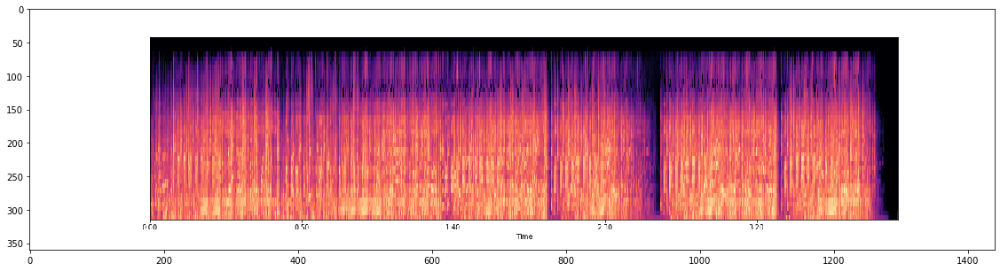

In [59]:
fig = plt.figure(figsize=(20,5))
image = plt.imread('./Data/Spectrograms/Images/313.png')
plt.imshow(image)

C:\Users\pc\Anaconda3\envs\music\lib\site-packages\ipykernel_launcher.py:4: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  after removing the cwd from sys.path.


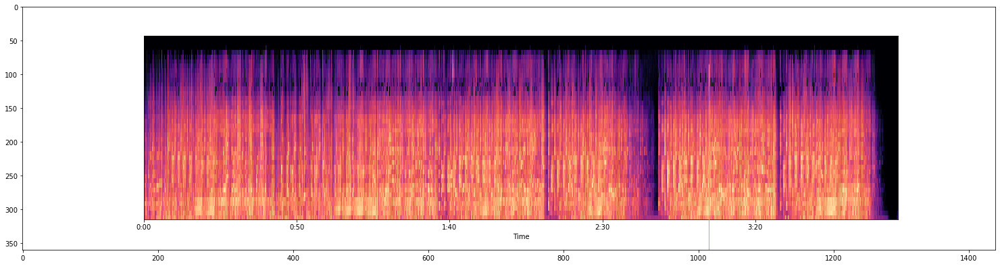

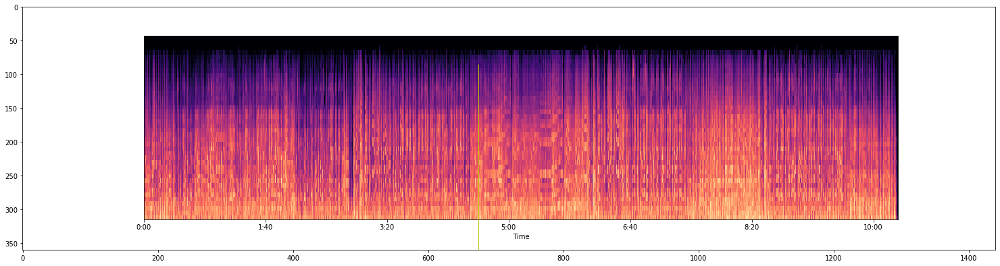

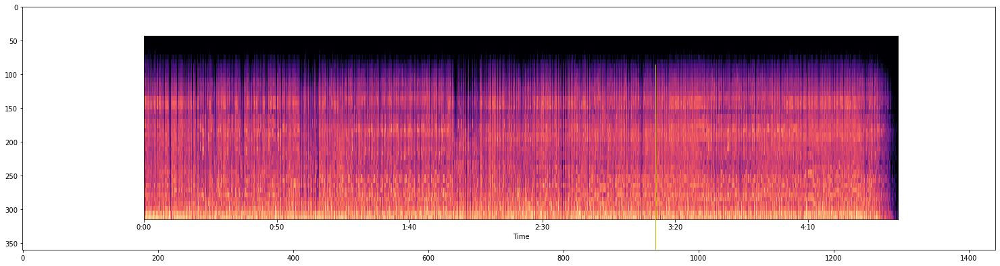

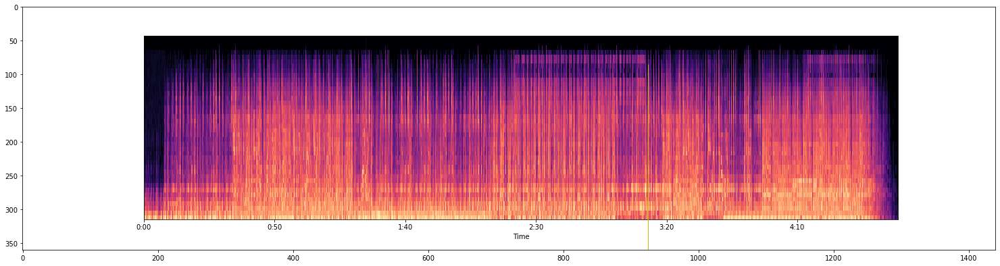

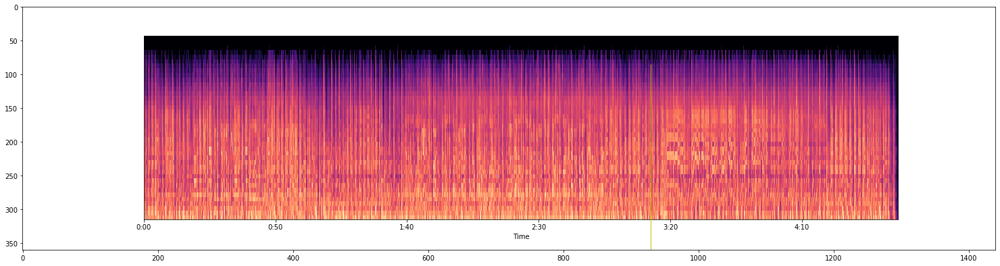

...

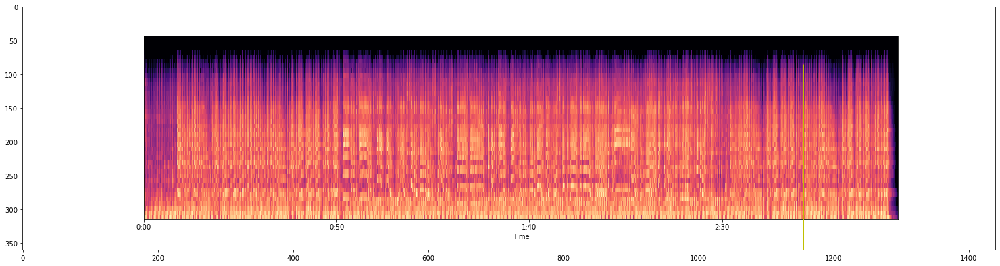

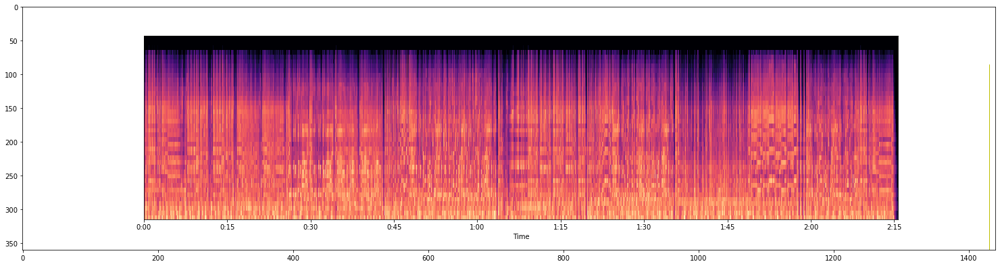

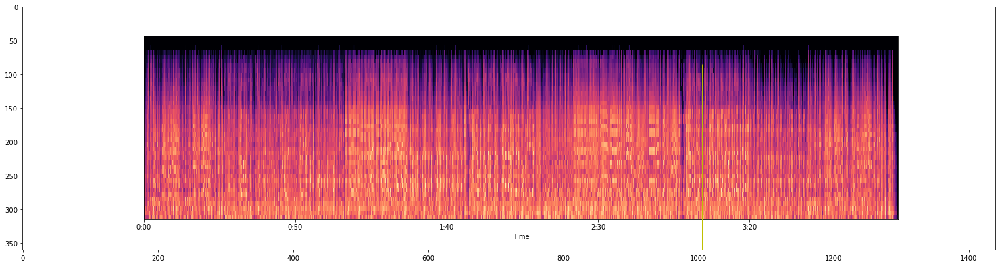

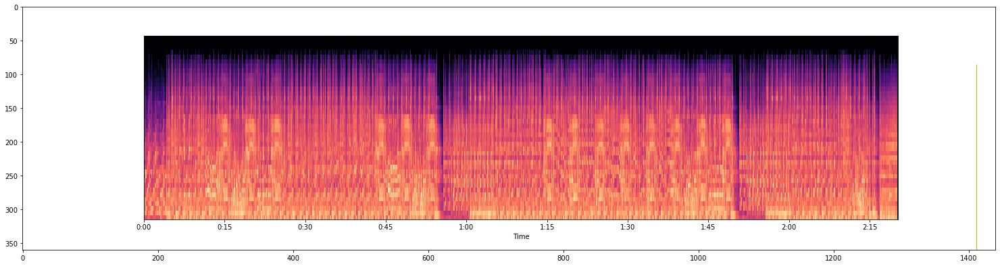

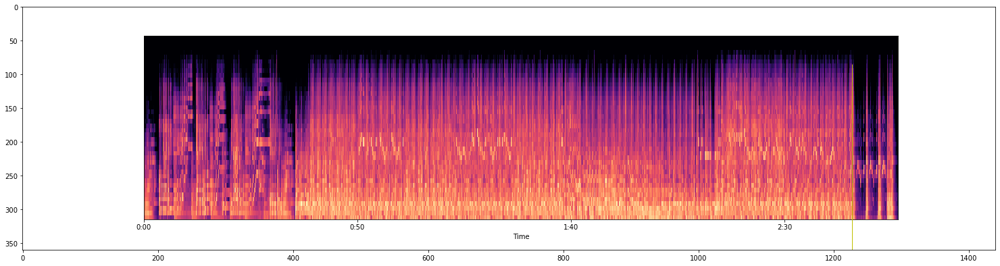

In [60]:
cont = 0
for idSong in songsLength.keys():
    
    fig = plt.figure(figsize=(20,5))

    #add axes to the image
    ax = fig.add_axes([0,0,1,1])


    # read and plot the image
    image = plt.imread('./Data/Spectrograms/Images/'+idSong+'.png')
    plt.imshow(image)

    # iterating over the image for different objects
    for _,row in train[train.image_names == idSong+".png"].iterrows():
        xmin = row.xmin
        xmax = row.xmax
        ymin = row.ymin
        ymax = row.ymax

        width = xmax - xmin
        height = ymax - ymin

        # assign different color to different classes of objects
        if row.cell_type == 'beat':
            edgecolor = 'y'
            #ax.annotate('B', xy=(xmax-40,ymin+20))

        # add bounding boxes to the image
        rect = patches.Rectangle((xmin,ymin), width, height, edgecolor = edgecolor, facecolor = 'none')

        ax.add_patch(rect)
        cont+=1
        if cont == 10:
            break

In [61]:
csv = "image_names,cell_type,xmin,xmax,ymin,ymax\n"

startX = 450
endX = 3240

for idSong in songsLength.keys():
    ymax = 630
    ymin = 85
    timeFile = songsLength[idSong]
    image = idSong+".png"
    ## sr / 4
    ## 
    secondValue = findValueOfPixel(startX, endX, timeFile)
    miliSecValue = secondValue/1000
    hopSizeSplit = miliSecValue*25
    hopSize = hopSizeSplit*2
    
    f = open("./Data/Processed_Songs/"+idSong+".txt", "r")
    while(True):
        line = f.readline()
        if line:
            
            # msg += str(int(beat*1000))+", bang;\n"
            aux = line.split("\n")
            tmp = aux[0].split(",")
            beat = int(tmp[0])/1000
            xmin, xmax, center = getBoxFromBeatX(beat, hopSizeSplit, secondValue)
            csv += image+",beat,"+str(math.ceil(xmin))+","+str(math.ceil(xmax))+","+str(math.ceil(ymin))+","+str(math.ceil(ymax))+"\n"
    
        else:
            break
    f.close()

  

In [62]:
f = open("./df.csv", "w")
f.write(csv)
f.close()

In [63]:
df = pd.read_csv("./df.csv")

In [64]:
df = df.drop(df[df.xmin > 3240].index)

In [65]:
df

,image_names,cell_type,xmin,xmax,ymin,ymax
0,313.png,beat,486,486,85,630
1,313.png,beat,498,498,85,630
2,313.png,beat,512,512,85,630
3,313.png,beat,522,522,85,630
4,313.png,beat,534,534,85,630
...,...,...,...,...,...,...
21379,731.png,beat,3190,3190,85,630
21380,731.png,beat,3202,3202,85,630
21381,731.png,beat,3214,3214,85,630
21382,731.png,beat,3226,3226,85,630


C:\Users\pc\Anaconda3\envs\music\lib\site-packages\ipykernel_launcher.py:3: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  This is separate from the ipykernel package so we can avoid doing imports until


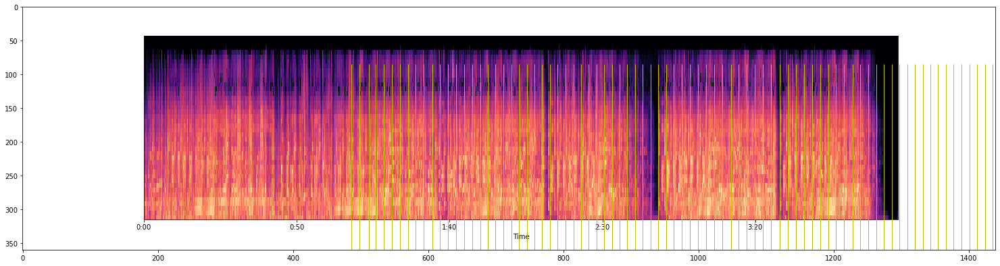

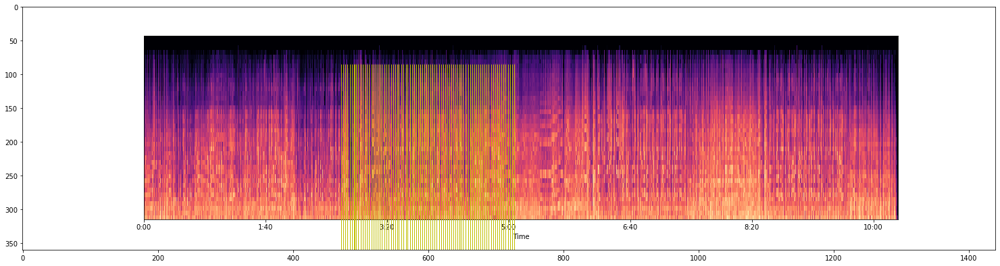

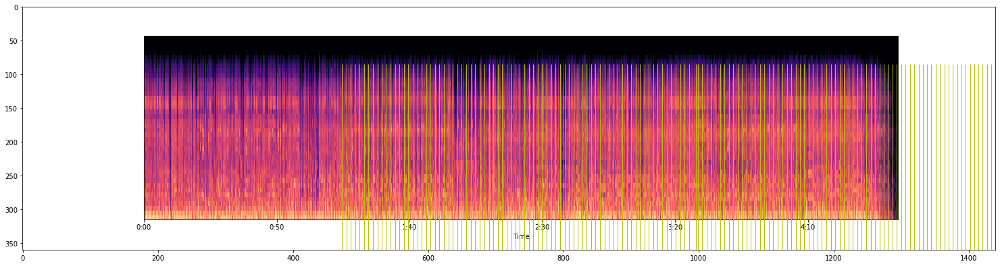

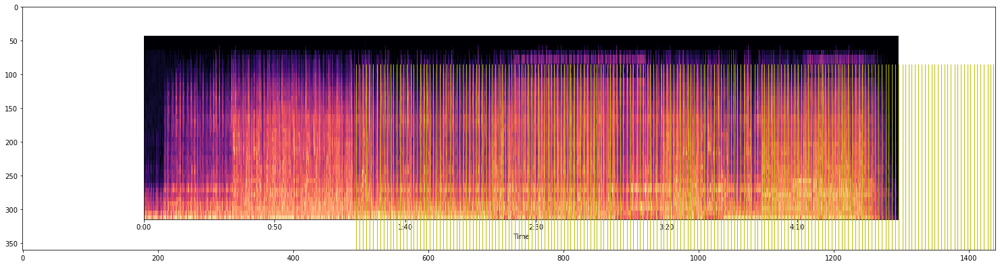

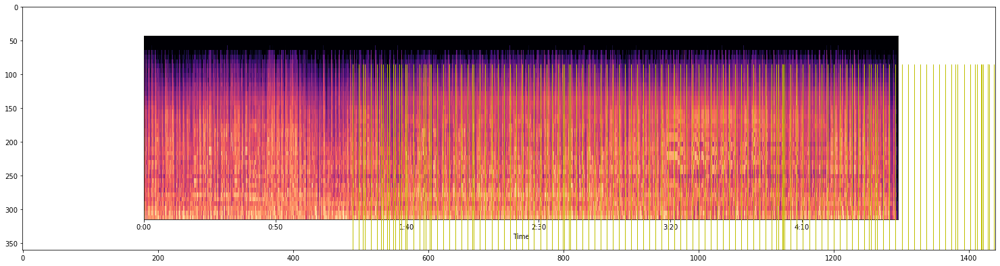

...

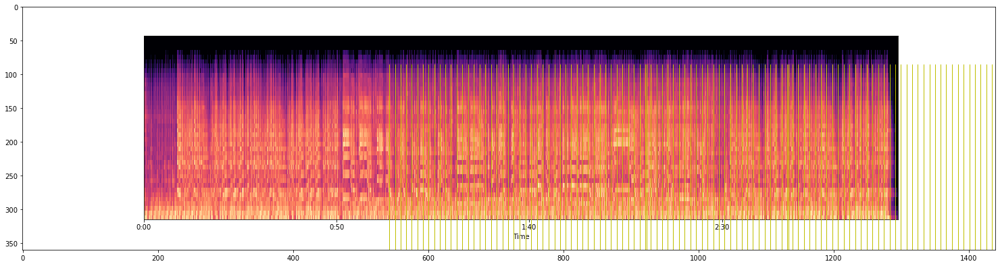

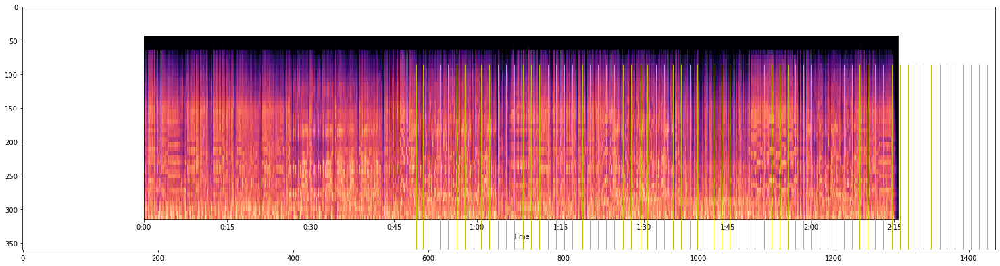

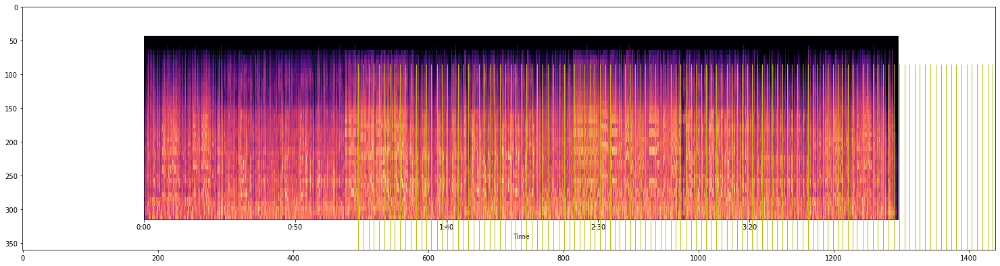

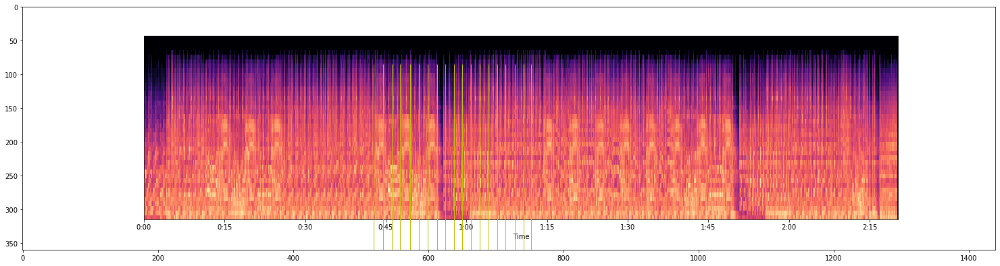

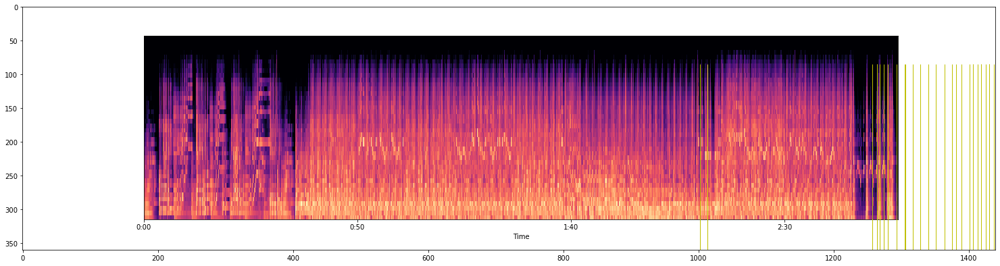

In [66]:
for idSong in songsLength.keys():
    
    fig = plt.figure(figsize=(20,5))

    #add axes to the image
    ax = fig.add_axes([0,0,1,1])


    # read and plot the image
    image = plt.imread('./Data/Spectrograms/Images/'+idSong+'.png')
    plt.imshow(image)

    # iterating over the image for different objects
    for _,row in df[df.image_names == idSong+".png"].iterrows():
        xmin = row.xmin
        xmax = row.xmax
        ymin = row.ymin
        ymax = row.ymax

        width = xmax - xmin
        height = ymax - ymin

        # assign different color to different classes of objects
        if row.cell_type == 'beat':
            edgecolor = 'y'
            #ax.annotate('B', xy=(xmax-40,ymin+20))

        # add bounding boxes to the image
        rect = patches.Rectangle((xmin,ymin), width, height, edgecolor = edgecolor, facecolor = 'none')

        ax.add_patch(rect)

In [67]:
images = df["image_names"].unique()

In [68]:
images

array(['313.png', '317.png', '324.png', '339.png', '346.png', '347.png',
       '350.png', '362.png', '365.png', '368.png', '380.png', '382.png',
       '388.png', '390.png', '391.png', '394.png', '396.png', '398.png',
       '404.png', '406.png', '410.png', '411.png', '418.png', '431.png',
       '432.png', '436.png', '438.png', '442.png', '445.png', '453.png',
       '464.png', '466.png', '467.png', '469.png', '470.png', '479.png',
       '492.png', '494.png', '499.png', '504.png', '506.png', '511.png',
       '519.png', '520.png', '526.png', '528.png', '539.png', '540.png',
       '542.png', '547.png', '552.png', '558.png', '585.png', '591.png',
       '599.png', '600.png', '603.png', '613.png', '625.png', '629.png',
       '632.png', '634.png', '637.png', '638.png', '639.png', '648.png',
       '671.png', '674.png', '699.png', '708.png', '716.png', '719.png',
       '721.png', '728.png', '731.png'], dtype=object)

In [69]:
random.seed(0)
random.shuffle(images)

train_data = images[:60]
test_data = images[60:]

In [70]:
train_data

array(['721.png', '585.png', '453.png', '382.png', '540.png', '638.png',
       '494.png', '317.png', '708.png', '671.png', '600.png', '506.png',
       '467.png', '728.png', '391.png', '519.png', '492.png', '432.png',
       '362.png', '380.png', '394.png', '552.png', '466.png', '625.png',
       '599.png', '436.png', '511.png', '388.png', '438.png', '431.png',
       '324.png', '313.png', '339.png', '603.png', '719.png', '445.png',
       '526.png', '632.png', '390.png', '410.png', '639.png', '418.png',
       '731.png', '479.png', '464.png', '411.png', '520.png', '346.png',
       '539.png', '629.png', '406.png', '368.png', '674.png', '613.png',
       '716.png', '470.png', '396.png', '699.png', '504.png', '350.png'],
      dtype=object)

In [71]:
test_data

array(['542.png', '365.png', '404.png', '398.png', '442.png', '528.png',
       '634.png', '499.png', '558.png', '637.png', '648.png', '469.png',
       '347.png', '591.png', '547.png'], dtype=object)

In [72]:
data = pd.DataFrame()
data['format'] = df['image_names']

# as the images are in train_images folder, add train_images before the image name
for i in range(data.shape[0]):
    data['format'][i] = 'train_images/' + data['format'][i]

# add xmin, ymin, xmax, ymax and class as per the format required
for i in range(data.shape[0]):
    data['format'][i] = data['format'][i] + ',' + str(df['xmin'][i]) + ',' + str(df['ymin'][i]) + ',' + str(df['xmax'][i]) + ',' + str(df['ymax'][i]) + ',' + df['cell_type'][i]

data.to_csv('annotate.txt', header=None, index=None, sep=' ')

KeyError: 1248

In [ ]:
test_data = "632.png", "634.png", "637.png", "638.png", "639.png", "648.png", "671.png", "674.png", "699.png", "708.png", "716.png", "719.png", "721.png", "728.png", "731.png"

In [ ]:
test_data

In [ ]:
sr